In [ ]:
import chess
import chess.pgn
import chess.engine
import networkx as nx
import numpy as np
from collections import Counter
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

import chess.svg
import matplotlib.pyplot as plt
import io
from PIL import Image
import numpy as np

import cairosvg



In [1]:
!pip install cairosvg

  Using cached defusedxml-0.7.1-py2.py3-none-any.whl.metadata (32 kB)
  Using cached tinycss2-1.4.0-py3-none-any.whl.metadata (3.0 kB)
  Using cached cffi-1.17.1-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (1.5 kB)
  Using cached webencodings-0.5.1-py2.py3-none-any.whl.metadata (2.1 kB)
  Using cached pycparser-2.22-py3-none-any.whl.metadata (943 bytes)
Using cached defusedxml-0.7.1-py2.py3-none-any.whl (25 kB)
Using cached tinycss2-1.4.0-py3-none-any.whl (26 kB)
Using cached cffi-1.17.1-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (479 kB)
Using cached webencodings-0.5.1-py2.py3-none-any.whl (11 kB)
Using cached pycparser-2.22-py3-none-any.whl (117 kB)

[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [2]:
!pip install chess

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 46.5 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
  Created wheel for chess: filename=chess-1.11.2-py3-none-any.whl size=147776 sha256=a90812dd03ba4dcbeab59329cd2de86b484ec2e51779517d86fe147ef5899a9f
  Stored in directory: /root/.cache/pip/wheels/7a/79/8e/0d6e404db9f1e82af2e40b49161d6acab485d75dfb0470ac08
Successfully built chess


#  Graph Construction: Support, Mobility, and Position


In [ ]:
import chess
import chess.pgn
import networkx as nx
import matplotlib.pyplot as plt

# --- Create Support Network ---
def create_support_network(board):
    G = nx.DiGraph()
    current_color = board.turn
    for square in chess.SQUARES:
        G.add_node(square, color=board.piece_at(square).color if board.piece_at(square) else None)
    for square in chess.SQUARES:
        piece = board.piece_at(square)
        if piece and piece.color == current_color:
            for attacked_square in board.attacks(square):
                attacked_piece = board.piece_at(attacked_square)
                if attacked_piece and attacked_piece.color == current_color:
                    G.add_edge(square, attacked_square, color='green', type='support')
    return G

# --- Create Mobility Network ---
def create_mobility_network(board):
    G = nx.DiGraph()
    current_color = board.turn
    for square in chess.SQUARES:
        G.add_node(square, color=board.piece_at(square).color if board.piece_at(square) else None)
    for move in board.legal_moves:
        source = move.from_square
        dest = move.to_square
        piece = board.piece_at(source)
        if piece and piece.color == current_color:
            G.add_edge(source, dest, color='red', type='attack')
    return G


def create_position_network(support_G, mobility_G):
    G = nx.DiGraph()

    G.add_nodes_from(support_G.nodes(data=True))
    G.add_edges_from(support_G.edges(data=True))
    G.add_edges_from(mobility_G.edges(data=True))
    return G

In [10]:


def compute_network_features(G, color):
    features = {}
    component_nodes = [n for n, d in G.nodes(data=True) if d.get('color') == color]
    if not component_nodes:
        return {f'f{i}': 0 for i in range(1, 57)}
    subgraph = G.subgraph(component_nodes).copy()
    G_undir = subgraph.to_undirected()
    opposing_color = not color
    opposing_nodes = [n for n, d in G.nodes(data=True) if d.get('color') == opposing_color]
    
    degrees = dict(G_undir.degree())  # Use undirected for consistency with paper
    wccs = list(nx.connected_components(G_undir)) if G_undir.nodes else []
    wccs_large = [cc for cc in wccs if len(cc) > 1]
    sccs = list(nx.strongly_connected_components(subgraph)) if subgraph.nodes else []
    sccs_large = [cc for cc in sccs if len(cc) > 1]
    n_nodes = len(subgraph.nodes)
    
    # 1: Smallest degree > 0
    deg_vals = list(degrees.values())
    features['f1'] = min([d for d in deg_vals if d > 0]) if any(d > 0 for d in deg_vals) else 0
    
    # 2: Largest degree
    features['f2'] = max(deg_vals) if deg_vals else 0
    
    # 3: Average degree
    features['f3'] = np.mean(deg_vals) if deg_vals else 0
    
    # 4: Degree distribution (5 bins to limit features)
    if deg_vals:
        max_deg = max(deg_vals)
        bins = min(max_deg + 1, 5)  # Cap at 5 bins
        hist, _ = np.histogram(deg_vals, bins=bins, range=(0, bins), density=False)
        for i, count in enumerate(hist[:5], 4):
            features[f'f{i}'] = count / n_nodes * 100 if n_nodes else 0  # % nodes
        for i in range(len(hist), 5):
            features[f'f{i+4}'] = 0
    else:
        for i in range(4, 9):
            features[f'f{i}'] = 0
    
    # 5: Graph density
    features['f9'] = nx.density(G_undir) if n_nodes > 1 else 0
    
    # 6: Number of nodes
    features['f10'] = n_nodes
    
    # 7: Number of edges
    features['f11'] = G_undir.number_of_edges()
    
    # 8: Number of WCCs > 1
    features['f12'] = len(wccs_large)
    
    # 9: Number of SCCs > 1
    features['f13'] = len(sccs_large)
    
    # 10: Number of trees > 1
    tree_count = sum(1 for cc in wccs_large if G_undir.subgraph(cc).number_of_edges() == len(cc) - 1)
    features['f14'] = tree_count
    
    # 11: % nodes in WCCs > 1
    nodes_in_wccs_large = sum(len(cc) for cc in wccs_large)
    features['f15'] = nodes_in_wccs_large / n_nodes * 100 if n_nodes else 0
    
    # 12: % nodes in SCCs > 1
    nodes_in_sccs_large = sum(len(cc) for cc in sccs_large)
    features['f16'] = nodes_in_sccs_large / n_nodes * 100 if n_nodes else 0
    
    # 13: % nodes in trees > 1
    trees_large = [cc for cc in wccs_large if G_undir.subgraph(cc).number_of_edges() == len(cc) - 1]
    nodes_in_trees = sum(len(cc) for cc in trees_large)
    features['f17'] = nodes_in_trees / n_nodes * 100 if n_nodes else 0
    
    # 14: % nodes in WCCs of size 1
    nodes_in_single = sum(1 for cc in wccs if len(cc) == 1)
    features['f18'] = nodes_in_single / n_nodes * 100 if n_nodes else 0
    
    # 15: % nodes in smallest WCC > 1
    smallest_wcc_size = min([len(cc) for cc in wccs_large]) if wccs_large else 0
    features['f19'] = smallest_wcc_size / n_nodes * 100 if n_nodes and wccs_large else 0
    
    # 16: % nodes in largest WCC
    largest_wcc_size = max([len(cc) for cc in wccs]) if wccs else 0
    features['f20'] = largest_wcc_size / n_nodes * 100 if n_nodes else 0
    
    # 17: Avg % nodes in WCCs > 1
    wcc_percentages = [len(cc) / n_nodes * 100 for cc in wccs_large] if n_nodes else []
    features['f21'] = np.mean(wcc_percentages) if wcc_percentages else 0
    
    # 18: WCC size distribution (cap at 3 features)
    wcc_sizes = sorted([len(cc) / n_nodes * 100 for cc in wccs_large], reverse=True) if n_nodes else []
    for i in range(3):
        features[f'f{22+i}'] = wcc_sizes[i] if i < len(wcc_sizes) else 0
    
    # 19: Diameter of smallest WCC > 1
    wcc_diameters = [nx.diameter(G_undir.subgraph(cc)) for cc in wccs_large] if wccs_large else []
    features['f25'] = min(wcc_diameters) if wcc_diameters else 0
    
    # 20: Diameter of widest WCC
    features['f26'] = max(wcc_diameters) if wcc_diameters else 0
    
    # 21: Avg diameter of WCCs > 1
    features['f27'] = np.mean(wcc_diameters) if wcc_diameters else 0
    
    # 22: WCC diameter distribution (cap at 3)
    wcc_diam_dist = sorted(wcc_diameters, reverse=True) if wcc_diameters else []
    for i in range(3):
        features[f'f{28+i}'] = wcc_diam_dist[i] if i < len(wcc_diam_dist) else 0
    
    # 23: % nodes in smallest SCC > 1
    smallest_scc_size = min([len(cc) for cc in sccs_large]) if sccs_large else 0
    features['f31'] = smallest_scc_size / n_nodes * 100 if n_nodes and sccs_large else 0
    
    # 24: % nodes in largest SCC
    largest_scc_size = max([len(cc) for cc in sccs]) if sccs else 0
    features['f32'] = largest_scc_size / n_nodes * 100 if n_nodes else 0
    
    # 25: Avg % nodes in SCCs > 1
    scc_percentages = [len(cc) / n_nodes * 100 for cc in sccs_large] if n_nodes else []
    features['f33'] = np.mean(scc_percentages) if scc_percentages else 0
    
    # 26: SCC size distribution (cap at 3)
    scc_sizes = sorted([len(cc) / n_nodes * 100 for cc in sccs_large], reverse=True) if n_nodes else []
    for i in range(3):
        features[f'f{34+i}'] = scc_sizes[i] if i < len(scc_sizes) else 0
    
    # 27: Diameter of smallest SCC > 1
    scc_diameters = [nx.diameter(subgraph.subgraph(cc)) for cc in sccs_large if nx.is_strongly_connected(subgraph.subgraph(cc))] if sccs_large else []
    features['f37'] = min(scc_diameters) if scc_diameters else 0
    
    # 28: Diameter of widest SCC
    features['f38'] = max(scc_diameters) if scc_diameters else 0
    
    # 29: Avg diameter of SCCs > 1
    features['f39'] = np.mean(scc_diameters) if scc_diameters else 0
    
    # 30: SCC diameter distribution (cap at 3)
    scc_diam_dist = sorted(scc_diameters, reverse=True) if scc_diameters else []
    for i in range(3):
        features[f'f{40+i}'] = scc_diam_dist[i] if i < len(scc_diam_dist) else 0
    
    # 31: % nodes in trees of size 1
    features['f43'] = nodes_in_single / n_nodes * 100 if n_nodes else 0  # Same as f18
    
    # 32: % nodes in smallest tree > 1
    smallest_tree_size = min([len(cc) for cc in trees_large]) if trees_large else 0
    features['f44'] = smallest_tree_size / n_nodes * 100 if n_nodes and trees_large else 0
    
    # 33: % nodes in largest tree
    largest_tree_size = max([len(cc) for cc in trees_large]) if trees_large else 0
    features['f45'] = largest_tree_size / n_nodes * 100 if n_nodes and trees_large else 0
    
    # 34: Avg % nodes in trees > 1
    tree_percentages = [len(cc) / n_nodes * 100 for cc in trees_large] if n_nodes else []
    features['f46'] = np.mean(tree_percentages) if tree_percentages else 0
    
    # 35: Tree size distribution (cap at 3)
    tree_sizes = sorted([len(cc) / n_nodes * 100 for cc in trees_large], reverse=True) if n_nodes else []
    for i in range(3):
        features[f'f{47+i}'] = tree_sizes[i] if i < len(tree_sizes) else 0
    
    # 36–38: Tree depths (approximate as diameters)
    tree_depths = [nx.diameter(G_undir.subgraph(cc)) for cc in trees_large] if trees_large else []
    features['f50'] = min(tree_depths) if tree_depths else 0  # Smallest
    features['f51'] = max(tree_depths) if tree_depths else 0  # Widest
    features['f52'] = np.mean(tree_depths) if tree_depths else 0  # Average
    
    # 39: Tree diameter distribution (cap at 3)
    tree_diam_dist = sorted(tree_depths, reverse=True) if tree_depths else []
    for i in range(3):
        features[f'f{53+i}'] = tree_diam_dist[i] if i < len(tree_diam_dist) else 0
    
    # 40: Clustering coefficient
    features['f56'] = nx.average_clustering(G_undir) if n_nodes else 0
    
    # 41: Largest clique size
    cliques = list(nx.find_cliques(G_undir)) if n_nodes else []
    features['f57'] = max([len(c) for c in cliques]) if cliques else 0
    
    # 42: Min edge dominating set (approximation)
    matching = nx.maximal_matching(G_undir) if n_nodes else set()
    features['f58'] = len(matching) if matching else 0
    
    # 43: Max independent set size (approximation)
    features['f59'] = len(nx.maximal_independent_set(G_undir)) if n_nodes else 0
    
    # 44: Smallest maximal matching
    features['f60'] = len(nx.maximal_matching(G_undir)) if n_nodes else 0
    
    # 45: Degree assortativity
    features['f61'] = nx.degree_assortativity_coefficient(G_undir) if n_nodes > 1 else 0
    
    # 46: Transitivity
    features['f62'] = nx.transitivity(G_undir) if n_nodes else 0
    
    # 47: Number of attracting components
    features['f63'] = len(list(nx.attracting_components(subgraph))) if n_nodes else 0
    
    # 48: Nodes in 3-core
    core_3 = nx.k_core(G_undir, k=3) if n_nodes else nx.Graph()
    features['f64'] = core_3.number_of_nodes()
    
    # 49: Nodes in 2-core
    core_2 = nx.k_core(G_undir, k=2) if n_nodes else nx.Graph()
    features['f65'] = core_2.number_of_nodes()
    
    # 50: Rich club coefficient
    if n_nodes and max(deg_vals, default=0) > 0:
        try:
            rc = nx.rich_club_coefficient(G_undir, Q=1)
            max_deg = max(deg_vals)
            features['f66'] = rc.get(max_deg, 0)
        except:
            features['f66'] = 0
    else:
        features['f66'] = 0
    
    # 51: Ratio of friendly edges to opposing vs. within
    friendly_to_opposing = sum(1 for u, v in G.edges() if u in component_nodes and v in opposing_nodes)
    friendly_within = sum(1 for u, v in G.edges() if u in component_nodes and v in component_nodes)
    features['f67'] = friendly_to_opposing / friendly_within if friendly_within else 0
    
    # 52: Ratio of opposing in-edges to friendly out-edges
    opposing_to_friendly = sum(1 for u, v in G.edges() if u in opposing_nodes and v in component_nodes)
    features['f68'] = opposing_to_friendly / friendly_to_opposing if friendly_to_opposing else 0
    
    # 53: Avg friendly edges to opposing per node
    features['f69'] = friendly_to_opposing / n_nodes if n_nodes else 0
    
    # 54: Avg opposing edges entering friendly per node
    features['f70'] = opposing_to_friendly / n_nodes if n_nodes else 0
    
    # 55: % nodes with friendly edges to opposing
    nodes_with_friendly_to_opposing = sum(1 for u in component_nodes if any(v in opposing_nodes for v in G.successors(u)))
    features['f71'] = nodes_with_friendly_to_opposing / n_nodes * 100 if n_nodes else 0
    
    # 56: % nodes with opposing in-degree > 0
    nodes_with_opposing_in = sum(1 for n in component_nodes if any(u in opposing_nodes for u in G.predecessors(n)))
    features['f72'] = nodes_with_opposing_in / n_nodes * 100 if n_nodes else 0
    
    # Adjust to exactly 56 features
    final_features = {}
    for i in range(1, 57):
        if i <= 8:
            final_features[f'f{i}'] = features[f'f{i}']
        elif i == 9:
            final_features[f'f{i}'] = features['f9']
        elif i <= 17:
            final_features[f'f{i}'] = features[f'f{i+1}']
        elif i <= 56:
            final_features[f'f{i}'] = features[f'f{i+16}']
    
    assert len(features) == 72, f"Expected 72 features, got {len(features)}"
    return features

In [11]:
feature_names = [
        'min_degree', 'max_degree', 'avg_degree',
        'deg_dist_1', 'deg_dist_2', 'deg_dist_3', 'deg_dist_4', 'deg_dist_5',
        'density', 'node_count', 'edge_count', 'num_wcc_large', 'num_scc_large',
        'num_trees', 'pct_nodes_wcc_large', 'pct_nodes_scc_large', 'pct_nodes_trees',
        'pct_nodes_wcc_size1', 'pct_smallest_wcc', 'pct_largest_wcc', 'avg_pct_wcc_large',
        'wcc_size_dist_1', 'wcc_size_dist_2', 'wcc_size_dist_3',
        'min_wcc_diameter', 'max_wcc_diameter', 'avg_wcc_diameter',
        'wcc_diam_dist_1', 'wcc_diam_dist_2', 'wcc_diam_dist_3',
        'pct_smallest_scc', 'pct_largest_scc', 'avg_pct_scc_large',
        'scc_size_dist_1', 'scc_size_dist_2', 'scc_size_dist_3',
        'min_scc_diameter', 'max_scc_diameter', 'avg_scc_diameter',
        'scc_diam_dist_1', 'scc_diam_dist_2', 'scc_diam_dist_3',
        'pct_trees_size1', 'pct_smallest_tree', 'pct_largest_tree', 'avg_pct_trees_large',
        'tree_size_dist_1', 'tree_size_dist_2', 'tree_size_dist_3',
        'min_tree_depth', 'max_tree_depth', 'avg_tree_depth',
        'tree_diam_dist_1', 'tree_diam_dist_2', 'tree_diam_dist_3',
        'clustering_coeff', 'largest_clique', 'min_edge_dominating_set',
        'max_independent_set', 'smallest_maximal_matching', 'degree_assortativity',
        'transitivity', 'num_attracting_components', 'nodes_3_core', 'nodes_2_core',
        'rich_club_coeff', 'ratio_friendly_to_opposing', 'ratio_opposing_to_friendly',
        'avg_friendly_to_opposing', 'avg_opposing_to_friendly',
        'pct_friendly_to_opposing', 'pct_opposing_in_degree_gt0'
    ]

In [5]:
len(feature_names)

72

# dataset generator

In [19]:
!pip install pandas


  Using cached pandas-2.2.3-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (89 kB)
  Using cached pytz-2025.2-py2.py3-none-any.whl.metadata (22 kB)
  Using cached tzdata-2025.2-py2.py3-none-any.whl.metadata (1.4 kB)
Using cached pandas-2.2.3-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.7 MB)
Using cached pytz-2025.2-py2.py3-none-any.whl (509 kB)
Using cached tzdata-2025.2-py2.py3-none-any.whl (347 kB)

[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


In [17]:
def initialize_engine():
    """Initialize the Stockfish engine"""
    try:
        return chess.engine.SimpleEngine.popen_uci("./stockfish_")
    except Exception as e:
        print(f"Error initializing engine: {e}")
        return None

# Initialize engine
engine = initialize_engine()
if engine is None:
    print("Failed to initialize Stockfish engine")

In [13]:
from typing import Optional, Tuple
import chess
import chess.engine

def evaluate_position(board: chess.Board, engine: chess.engine.SimpleEngine, player: str, 
                     time_limit: float = 0.1) -> Tuple[Optional[float], str]:
    """
    Evaluates the current board strength from the player's perspective.

    Args:
        board: The current chess board position.
        engine: The chess engine instance (e.g., Stockfish).
        player: "white" or "black" to indicate the player's color.
        time_limit: Time limit for engine analysis in seconds.

    Returns:
        Tuple of (score in pawn units from player's perspective, strength label).
    """
    try:
        info = engine.analyse(board, chess.engine.Limit(time=time_limit))
        score_obj = info["score"].white() if player.lower() == "white" else info["score"].black()


        if score_obj.is_mate():
            mate_score = score_obj.mate()

            # Positive mate means the side to move is delivering mate
            # Negative mate means the side to move is being mated
            if (player.lower() == "white" and mate_score > 0) or (player.lower() == "black" and mate_score < 0):
                score = 10000  # Winning mate
                label = "strong"
            else:
                score = -10000  # Losing mate
                label = "weak"

            return score / 100.0, label

        # Get score in centipawns and convert to pawn units
        score = score_obj.score()
        if score is None:
            return None, "unknown"
        player_score = float(score) / 100.0

        # Adjust for player's perspective
        if player.lower() == "black":
            player_score = -player_score

        # Define thresholds (in pawn units)
        STRONG_THRESHOLD = 1.5
        WEAK_THRESHOLD = 0.26

        # Assign label
        if abs(player_score) <= WEAK_THRESHOLD:
            label = "neutral"
        elif abs(player_score) <= STRONG_THRESHOLD:
            label = "weak"
        else:
            label = "strong"

        return player_score, label

    except Exception as e:
        print(f"Evaluation error: {e}")
        return None, "unknown"


In [38]:
with open("single_game.pgn") as pgn_file:
    game = chess.pgn.read_game(pgn_file)

In [39]:


print("Processing first game:")
print(f"White: {game.headers.get('White', 'Unknown')}")
print(f"Black: {game.headers.get('Black', 'Unknown')}")
print(f"Result: {game.headers.get('Result', 'Unknown')}")
print("\nMove-by-move evaluation:\n")

board = chess.Board()
move_number = 0

for move in game.mainline_moves():
    move_number += 1
    try:
        player = "White" if move_number % 2 == 1 else "Black"
        move_san = board.san(move)
        board.push(move)

        score, label = evaluate_position(board, engine, player)

        if score is not None:
            print(f"Move {move_number//2 + 1}{'...' if player == 'Black' else '.'} {move_san} ({player})")
            print(board)  # Show board state
            print(f"  Score: {score:.2f}")
            print(f"  Label: {label}")
            print("-" * 40)
    except chess.IllegalMoveError as e:
        print(f"Illegal move: {e}")
        print(f"FEN: {board.fen()}")
        print(f"Move attempted: {move}")
        break
    except Exception as e:
        print(f"Error processing move: {e}")
        break


Processing first game:
White: 4ku 2.0 64-bit
Black: Chess Tiger 2007.1
Result: 1-0

Move-by-move evaluation:

Move 1. d4 (White)
r n b q k b n r
p p p p p p p p
. . . . . . . .
. . . . . . . .
. . . P . . . .
. . . . . . . .
P P P . P P P P
R N B Q K B N R
  Score: 0.28
  Label: weak
----------------------------------------
Move 2... Nf6 (Black)
r n b q k b . r
p p p p p p p p
. . . . . n . .
. . . . . . . .
. . . P . . . .
. . . . . . . .
P P P . P P P P
R N B Q K B N R
  Score: 0.28
  Label: weak
----------------------------------------
Move 2. Bg5 (White)
r n b q k b . r
p p p p p p p p
. . . . . n . .
. . . . . . B .
. . . P . . . .
. . . . . . . .
P P P . P P P P
R N . Q K B N R
  Score: 0.13
  Label: neutral
----------------------------------------
Move 3... Ne4 (Black)
r n b q k b . r
p p p p p p p p
. . . . . . . .
. . . . . . B .
. . . P n . . .
. . . . . . . .
P P P . P P P P
R N . Q K B N R
  Score: 0.32
  Label: weak
----------------------------------------
Move 3. Bf4 (Whi

# Fillter Raw-PNG game Data

In [ ]:
import chess.pgn

def is_valid_game(game):
    headers = game.headers


    # Check time control
    tc = headers.get("TimeControl")
    if not tc or tc == "-":
        return False

    try:
        if '+' in tc:
            base, _ = tc.split('+')
        else:
            base = tc
        base = int(base)
        if 2 * base < 480:  # At least 8 minutes total
            return False
    except ValueError:
        return False

    # Check for minimum full moves
    full_moves = sum(1 for _ in game.mainline_moves()) // 2
    if full_moves <= 25:
        return False

    return True

def filter_game_data(input_pgn_path, output_pgn_path):
    total_moves = 0
    saved_games = 0

    with open(input_pgn_path, "r", encoding="utf-8") as infile, \
         open(output_pgn_path, "w", encoding="utf-8") as outfile:

        while total_moves < 25000:
            game = chess.pgn.read_game(infile)
            if game is None:
                break

            if is_valid_game(game):
                moves = list(game.mainline_moves())
                total_moves += len(moves)
                outfile.write(str(game) + "\n\n")
                saved_games += 1

        print(f"Saved {saved_games} games with total of {total_moves} moves to '{output_pgn_path}'.")

# Example usage
filter_game_data("raw_game_data.pgn", "filtered_25k_moves.pgn")


Saved 297 games with total of 25033 moves to 'filtered_25k_moves.pgn'.


In [ ]:
import chess.pgn

def analyze_pgn(file_path):
    total_games = 0
    total_moves = 0

    with open(file_path, "r", encoding="utf-8") as pgn_file:
        while True:
            game = chess.pgn.read_game(pgn_file)
            if game is None:
                break  # No more games
            total_games += 1
            total_moves += len(list(game.mainline_moves()))

            # Count moves in this game

  

    print(f"Total number of games: {total_games}")
    print(f"Total number of moves: {total_moves}")
   

# Replace with your actual PGN file path
analyze_pgn("raw_game_data.pgn")


Total number of games: 1209291
Total number of moves: 81097605


# Dataset_Generator 

## Feature extraction 
### Combining  Graph + Domain Knowledge based feature extraction

In [ ]:
import chess
import chess.pgn
import networkx as nx
import numpy as np
import csv
from typing import List, Dict, Tuple

# Piece-square imortance table   (simplified, midgame values)
PIECE_SQUARE_TABLES = {
    chess.PAWN: [
        0,  0,  0,  0,  0,  0,  0,  0,
        50, 50, 50, 50, 50, 50, 50, 50,
        10, 10, 20, 30, 30, 20, 10, 10,
        5,  5, 10, 25, 25, 10,  5,  5,
        0,  0,  0, 20, 20,  0,  0,  0,
        5, -5,-10,  0,  0,-10, -5,  5,
        5, 10, 10,-20,-20, 10, 10,  5,
        0,  0,  0,  0,  0,  0,  0,  0
    ],
    chess.KNIGHT: [
        -50,-40,-30,-30,-30,-30,-40,-50,
        -40,-20,  0,  0,  0,  0,-20,-40,
        -30,  0, 10, 15, 15, 10,  0,-30,
        -30,  5, 15, 20, 20, 15,  5,-30,
        -30,  0, 15, 20, 20, 15,  0,-30,
        -30,  5, 10, 15, 15, 10,  5,-30,
        -40,-20,  0,  5,  5,  0,-20,-40,
        -50,-40,-30,-30,-30,-30,-40,-50
    ],
    chess.BISHOP: [
        -20,-10,-10,-10,-10,-10,-10,-20,
        -10,  0,  0,  0,  0,  0,  0,-10,
        -10,  0,  5, 10, 10,  5,  0,-10,
        -10,  5,  5, 10, 10,  5,  5,-10,
        -10,  0, 10, 10, 10, 10,  0,-10,
        -10, 10, 10, 10, 10, 10, 10,-10,
        -10,  5,  0,  0,  0,  0,  5,-10,
        -20,-10,-10,-10,-10,-10,-10,-20
    ],
    chess.ROOK: [
        0,  0,  0,  0,  0,  0,  0,  0,
        5, 10, 10, 10, 10, 10, 10,  5,
        -5,  0,  0,  0,  0,  0,  0, -5,
        -5,  0,  0,  0,  0,  0,  0, -5,
        -5,  0,  0,  0,  0,  0,  0, -5,
        -5,  0,  0,  0,  0,  0,  0, -5,
        -5,  0,  0,  0,  0,  0,  0, -5,
        0,  0,  0,  5,  5,  0,  0,  0
    ],
    chess.QUEEN: [
        -20,-10,-10, -5, -5,-10,-10,-20,
        -10,  0,  0,  0,  0,  0,  0,-10,
        -10,  0,  5,  5,  5,  5,  0,-10,
        -5,  0,  5,  5,  5,  5,  0, -5,
        0,  0,  5,  5,  5,  5,  0, -5,
        -10,  5,  5,  5,  5,  5,  0,-10,
        -10,  0,  5,  0,  0,  0,  0,-10,
        -20,-10,-10, -5, -5,-10,-10,-20
    ],
    chess.KING: [
        -30,-40,-40,-50,-50,-40,-40,-30,
        -30,-40,-40,-50,-50,-40,-40,-30,
        -30,-40,-40,-50,-50,-40,-40,-30,
        -30,-40,-40,-50,-50,-40,-40,-30,
        -20,-30,-30,-40,-40,-30,-30,-20,
        -10,-20,-20,-20,-20,-20,-20,-10,
        10, 10,-10,-10,-10,-10, 10, 10,
        20, 30, 10,  0,  0, 10, 30, 20
    ]
}

def get_material_features(board):
  
    features = []
    for color in [chess.WHITE, chess.BLACK]:
        for piece_type in chess.PIECE_TYPES:
            count = len(board.pieces(piece_type, color))
            features.append(count)
    return features

def get_piece_square_features(board):
    """Extract 12 piece-square features: sum of PST values per piece type per color."""
    features = []
    for color in [chess.WHITE, chess.BLACK]:
        for piece_type in chess.PIECE_TYPES:
            total = 0
            for square in board.pieces(piece_type, color):
                if color == chess.WHITE:
                    total += PIECE_SQUARE_TABLES[piece_type][square]
                else:
                    total += PIECE_SQUARE_TABLES[piece_type][chess.square_mirror(square)]
            features.append(total)
    return features

def get_mobility_features(board):
    """Extract 10 mobility features: total legal moves for non-pawns per color."""
    features = []
    for color in [chess.WHITE, chess.BLACK]:
        original_turn = board.turn
        board.turn = color
        all_legal_moves = list(board.legal_moves)
        
        for piece_type in [chess.KNIGHT, chess.BISHOP, chess.ROOK, chess.QUEEN, chess.KING]:
            total_moves = 0
            for square in board.pieces(piece_type, color):
                total_moves += sum(1 for move in all_legal_moves if move.from_square == square)
            features.append(total_moves)
        
        board.turn = original_turn
    return features

def get_king_safety_features(board):
    """Extract 4 king safety features per color."""
    features = []
    for color in [chess.WHITE, chess.BLACK]:
        king_square = board.king(color)
        if king_square is None:
            features.extend([0, 0])
            continue

        file_dist = max(3.5 - chess.square_file(king_square), 0) + max(chess.square_file(king_square) - 4.5, 0)
        rank_dist = max(3.5 - chess.square_rank(king_square), 0) + max(chess.square_rank(king_square) - 4.5, 0)
        center_dist = file_dist + rank_dist

        pawn_shield = 0
        king_file = chess.square_file(king_square)
        king_rank = chess.square_rank(king_square)
        direction = 1 if color == chess.WHITE else -1
        for file_offset in [-1, 0, 1]:
            shield_square = chess.square(king_file + file_offset, king_rank + direction)
            if 0 <= shield_square < 64:
                piece = board.piece_at(shield_square)
                if piece and piece.piece_type == chess.PAWN and piece.color == color:
                    pawn_shield += 1

        features.extend([center_dist, pawn_shield])
    return features

def get_pawn_structure_features(board):
    """Extract 8 pawn structure features: doubled, isolated, passed, chains per color."""
    features = []
    for color in [chess.WHITE, chess.BLACK]:
        pawns = list(board.pieces(chess.PAWN, color))
        files_with_pawns = [chess.square_file(square) for square in pawns]

        doubled = sum(max(files_with_pawns.count(f) - 1, 0) for f in set(files_with_pawns))
        isolated = sum(1 for f in set(files_with_pawns) if f - 1 not in files_with_pawns and f + 1 not in files_with_pawns)
        passed = 0
        for square in pawns:
            file = chess.square_file(square)
            rank = chess.square_rank(square)
            is_passed = True
            for r in range(rank + (1 if color == chess.WHITE else -1), (8 if color == chess.WHITE else -1), 1 if color == chess.WHITE else -1):
                for f in [file - 1, file, file + 1]:
                    if 0 <= f <= 7:
                        enemy_square = chess.square(f, r)
                        piece = board.piece_at(enemy_square)
                        if piece and piece.piece_type == chess.PAWN and piece.color != color:
                            is_passed = False
                            break
                if not is_passed:
                    break
            if is_passed:
                passed += 1

        chains = 0
        for square in pawns:
            file = chess.square_file(square)
            rank = chess.square_rank(square)
            direction = 1 if color == chess.WHITE else -1
            for file_offset in [-1, 1]:
                chain_square = chess.square(file + file_offset, rank - direction)
                if 0 <= chain_square < 64:
                    piece = board.piece_at(chain_square)
                    if piece and piece.piece_type == chess.PAWN and piece.color == color:
                        chains += 1
                        break

        features.extend([doubled, isolated, passed, chains])
    return features

def generate_support_network(board):
    """Generate the support network for network-based features."""
    G = nx.DiGraph()
    for square in chess.SQUARES:
        piece = board.piece_at(square)
        if piece:
            G.add_node(chess.square_name(square), color='white' if piece.color else 'black')
    
    for source_square in chess.SQUARES:
        piece = board.piece_at(source_square)
        if piece:
            color = piece.color
            attacks = board.attacks(source_square)
            for target_square in attacks:
                target_piece = board.piece_at(target_square)
                if target_piece and target_piece.color == color:
                    G.add_edge(
                        chess.square_name(source_square),
                        chess.square_name(target_square),
                        type='defend',
                        color='white' if color else 'black'
                    )
    return G

def generate_mobility_network(board):
    """Generate the mobility network for network-based features."""
    G = nx.DiGraph()
    for square in chess.SQUARES:
        piece = board.piece_at(square)
        color = 'white' if piece and piece.color else 'black' if piece else None
        G.add_node(chess.square_name(square), color=color)
    
    for move in board.legal_moves:
        from_square = chess.square_name(move.from_square)
        to_square = chess.square_name(move.to_square)
        piece = board.piece_at(move.from_square)
        G.add_edge(
            from_square,
            to_square,
            type='attack',
            color='white' if piece.color else 'black'
        )
    return G

def get_network_features(board):
    """Extract 10 network-based features from support and mobility networks."""
    support_network = generate_support_network(board)
    mobility_network = generate_mobility_network(board)
    
    features = []
    for G, name in [(support_network, 'support'), (mobility_network, 'mobility')]:
        if G.number_of_nodes() == 0:
            features.extend([0] * 5)
            continue
        
        G_undirected = G.to_undirected()
        avg_degree = sum(dict(G.degree()).values()) / G.number_of_nodes()
        clustering = nx.average_clustering(G_undirected)
        num_nodes = G.number_of_nodes()
        num_edges = G.number_of_edges()
        centrality = np.mean(list(nx.degree_centrality(G_undirected).values()))
        
        features.extend([avg_degree, clustering, num_nodes, num_edges, centrality])
    
    return features

def extract_56_features_from_board(board):
    features = []
    features.extend(get_material_features(board))
    features.extend(get_piece_square_features(board))
    features.extend(get_mobility_features(board))
    features.extend(get_king_safety_features(board))
    features.extend(get_pawn_structure_features(board))
    features.extend(get_network_features(board))
    return features

def generate_features_and_labels_streamed(pgn_path: str, output_csv: str, engine):
  feature_names = [
        # Material features (12): 6 for player, 6 for opponent
        'player_pawns', 'player_knights', 'player_bishops', 'player_rooks', 'player_queens', 'player_kings',
        'opponent_pawns', 'opponent_knights', 'opponent_bishops', 'opponent_rooks', 'opponent_queens', 'opponent_kings',
        # Piece-square features (12): 6 for player, 6 for opponent
        'player_pawn_pst', 'player_knight_pst', 'player_bishop_pst', 'player_rook_pst', 'player_queen_pst', 'player_king_pst',
        'opponent_pawn_pst', 'opponent_knight_pst', 'opponent_bishop_pst', 'opponent_rook_pst', 'opponent_queen_pst', 'opponent_king_pst',
        # Mobility features (10): 5 for player, 5 for opponent
        'player_knight_mobility', 'player_bishop_mobility', 'player_rook_mobility', 'player_queen_mobility', 'player_king_mobility',
        'opponent_knight_mobility', 'opponent_bishop_mobility', 'opponent_rook_mobility', 'opponent_queen_mobility', 'opponent_king_mobility',
        # King safety features (4): 2 for player, 2 for opponent
        'player_king_center_dist', 'player_king_pawn_shield', 'opponent_king_center_dist', 'opponent_king_pawn_shield',
        # Pawn structure features (8): 4 for player, 4 for opponent
        'player_doubled_pawns', 'player_isolated_pawns', 'player_passed_pawns', 'player_pawn_chains',
        'opponent_doubled_pawns', 'opponent_isolated_pawns', 'opponent_passed_pawns', 'opponent_pawn_chains',
        # Network-based features (10): Shared for the board
        'support_avg_degree', 'support_clustering', 'support_nodes', 'support_edges', 'support_centrality',
        'mobility_avg_degree', 'mobility_clustering', 'mobility_nodes', 'mobility_edges', 'mobility_centrality'
    ]

    header = feature_names + ['y_label']
   

    try:
        with open(pgn_path, 'r', encoding='utf-8') as pgn_file, \
             open(output_csv, 'w', newline='', encoding='utf-8') as csv_file:

            writer = csv.DictWriter(csv_file, fieldnames=header)
            writer.writeheader()

            game_count = 0
            move_count = 0

            while True:
                # if move_count >= move_limit:
                #     print(f"Reached move limit of {move_limit}. Stopping.")
                #     break

                game = chess.pgn.read_game(pgn_file)
                if game is None:
                    break

                board = game.board()
                for move in game.mainline_moves():
                    # if move_count >= move_limit:
                    #     print(f"Reached move limit of {move_limit}. Stopping.")
                    #     break

                    try:
                        board.push(move)

                        current_player_color = chess.BLACK if board.turn == False else chess.WHITE
                        player_name = "White" if current_player_color == chess.WHITE else "Black"

                        # Extract the 56 features
                        features = extract_56_features_from_board(board)

                        score, label = evaluate_position(board, engine, player_name)

                        if score is not None and label is not None:
                            row = {'y_label': label}
                            for idx, fname in enumerate(feature_names):
                                row[fname] = features[idx]
                            writer.writerow(row)
                            move_count += 1

                    except Exception as e:
                        print(f"Error at move {move_count} in game {game_count}: {e}")
                        break

                game_count += 1



        print(f"Finished writing {move_count} moves from {game_count} games to {output_csv}")

    except FileNotFoundError:
        print(f"PGN file not found: {pgn_path}")
    except Exception as e:
        print(f"Unexpected error: {e}")

pgn_path = "filtered_25k_moves.pgn"
output_csv = "chess_features.csv"
generate_features_and_labels_streamed(pgn_path, output_csv, engine)

Finished writing 25033 moves from 297 games to chess_features.csv


##### end 


# Feature extraction 
### When only Graph Based Features are extracted

In [ ]:
import chess
import chess.pgn
import csv
from typing import List, Dict, Tuple

def generate_features_and_labels_streamed(pgn_path: str, output_csv: str, engine):
    feature_names = [
        'min_degree', 'max_degree', 'avg_degree',
        'deg_dist_1', 'deg_dist_2', 'deg_dist_3', 'deg_dist_4', 'deg_dist_5',
        'density', 'node_count', 'edge_count', 'num_wcc_large', 'num_scc_large',
        'num_trees', 'pct_nodes_wcc_large', 'pct_nodes_scc_large', 'pct_nodes_trees',
        'pct_nodes_wcc_size1', 'pct_smallest_wcc', 'pct_largest_wcc', 'avg_pct_wcc_large',
        'wcc_size_dist_1', 'wcc_size_dist_2', 'wcc_size_dist_3',
        'min_wcc_diameter', 'max_wcc_diameter', 'avg_wcc_diameter',
        'wcc_diam_dist_1', 'wcc_diam_dist_2', 'wcc_diam_dist_3',
        'pct_smallest_scc', 'pct_largest_scc', 'avg_pct_scc_large',
        'scc_size_dist_1', 'scc_size_dist_2', 'scc_size_dist_3',
        'min_scc_diameter', 'max_scc_diameter', 'avg_scc_diameter',
        'scc_diam_dist_1', 'scc_diam_dist_2', 'scc_diam_dist_3',
        'pct_trees_size1', 'pct_smallest_tree', 'pct_largest_tree', 'avg_pct_trees_large',
        'tree_size_dist_1', 'tree_size_dist_2', 'tree_size_dist_3',
        'min_tree_depth', 'max_tree_depth', 'avg_tree_depth',
        'tree_diam_dist_1', 'tree_diam_dist_2', 'tree_diam_dist_3',
        'clustering_coeff', 'largest_clique', 'min_edge_dominating_set',
        'max_independent_set', 'smallest_maximal_matching', 'degree_assortativity',
        'transitivity', 'num_attracting_components', 'nodes_3_core', 'nodes_2_core',
        'rich_club_coeff', 'ratio_friendly_to_opposing', 'ratio_opposing_to_friendly',
        'avg_friendly_to_opposing', 'avg_opposing_to_friendly',
        'pct_friendly_to_opposing', 'pct_opposing_in_degree_gt0'
    ]

    header = feature_names + ['y_label']
    

    try:
        with open(pgn_path, 'r', encoding='utf-8') as pgn_file, \
             open(output_csv, 'w', newline='', encoding='utf-8') as csv_file:

            writer = csv.DictWriter(csv_file, fieldnames=header)
            writer.writeheader()

            game_count = 0
            move_count = 0

            while True:
     
                game = chess.pgn.read_game(pgn_file)
                if game is None:
                    break

                board = game.board()
                for move in game.mainline_moves():
              
                    try:
                        board.push(move)

                        current_player_color = chess.BLACK if board.turn == False else chess.WHITE
                        player_name = "White" if current_player_color == chess.WHITE else "Black"

                        # Create networks and features
                        support_G = create_support_network(board)
                        mobility_G = create_mobility_network(board)
                        position_G = create_position_network(support_G, mobility_G)
                        features = compute_network_features(position_G, current_player_color)

                        score, label = evaluate_position(board, engine, player_name)

                        if score is not None and label is not None:
                            row = {'y_label': label}
                            for idx, fname in enumerate(feature_names, start=1):
                                key = f'f{idx}'
                                row[fname] = features.get(key, 0.0)
                            writer.writerow(row)
                            move_count += 1

                    except Exception as e:
                        print(f"Error at move {move_count} in game {game_count}: {e}")
                        break

                game_count += 1

        print(f"Finished writing {move_count} moves from {game_count} games to {output_csv}")

    except FileNotFoundError:
        print(f"PGN file not found: {pgn_path}")
    except Exception as e:
        print(f"Unexpected error: {e}")



pgn_path = "filtered_25k_moves.pgn"
output_csv = "chess_features.csv"
generate_features_and_labels_streamed(pgn_path, output_csv, engine)


Finished writing 25033 moves from 297 games to chess_features.csv


# Visualization 


#### Random Board State Generation  

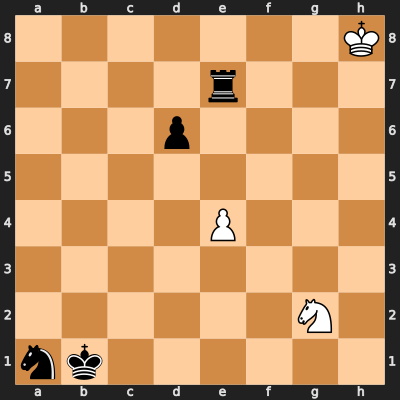

In [ ]:
import chess
import chess.svg
import networkx as nx
import matplotlib.pyplot as plt
from IPython.display import SVG, display
import random

# --- Draw Graph ---
## saved at current directory

def draw_graph(G, board, title):
    # Adjust position to place a1 at bottom-left (x: a to h left to right, y: 1 to 8 bottom to top)
    pos = {sq: (sq % 8, sq // 8) for sq in G.nodes()}
    node_colors = []

    for sq in G.nodes:
        piece = board.piece_at(sq)
        if piece is None:
            node_colors.append("white")
        else:
            node_colors.append("gray" if piece.color == chess.WHITE else "black")

    edge_colors = [G[u][v]['color'] for u, v in G.edges()]
    edge_styles = ['solid' if G[u][v]['type'] == 'support' else 'dashed' for u, v in G.edges()]

    plt.figure(figsize=(8, 8))
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500)
    nx.draw_networkx_labels(G, pos, labels={sq: chess.square_name(sq) for sq in G.nodes()}, font_size=8)
    
    # Draw all edges at once
    nx.draw_networkx_edges(G, pos, edge_color=edge_colors, style=edge_styles, arrows=True)

    plt.title(title)
    plt.axis('off')
    plt.savefig(f'{title.replace(" ", "_")}.png')
    plt.close()

def create_support_network(board):
    G = nx.DiGraph()
    current_color = board.turn
    for square in chess.SQUARES:
        G.add_node(square, color=board.piece_at(square).color if board.piece_at(square) else None)
    for square in chess.SQUARES:
        piece = board.piece_at(square)
        if piece and piece.color == current_color:
            for attacked_square in board.attacks(square):
                attacked_piece = board.piece_at(attacked_square)
                if attacked_piece and attacked_piece.color == current_color:
                    G.add_edge(square, attacked_square, color='green', type='support')
    return G

def create_mobility_network(board):
    G = nx.DiGraph()
    current_color = board.turn
    for square in chess.SQUARES:
        G.add_node(square, color=board.piece_at(square).color if board.piece_at(square) else None)
    for move in board.legal_moves:
        source = move.from_square
        dest = move.to_square
        piece = board.piece_at(source)
        if piece and piece.color == current_color:
            G.add_edge(source, dest, color='red', type='attack')
    return G

# Create Position Network
def create_position_network(support_G, mobility_G):
    G = nx.DiGraph()
    G.add_nodes_from(support_G.nodes(data=True))
    G.add_edges_from(support_G.edges(data=True))
    G.add_edges_from(mobility_G.edges(data=True))
    return G


def generate_random_board():
    board = chess.Board()
    board.clear()  # Clear the board to start with an empty position

    # Place kings to ensure a valid position
    white_king_square = random.choice(chess.SQUARES)
    black_king_square = random.choice([sq for sq in chess.SQUARES if sq != white_king_square])
    board.set_piece_at(white_king_square, chess.Piece(chess.KING, chess.WHITE))
    board.set_piece_at(black_king_square, chess.Piece(chess.KING, chess.BLACK))

    # Randomly place some pieces (up to 10 additional pieces to avoid overly crowded boards)
    pieces = [chess.PAWN, chess.KNIGHT, chess.BISHOP, chess.ROOK, chess.QUEEN]
    for _ in range(random.randint(2, 10)):
        square = random.choice([sq for sq in chess.SQUARES if not board.piece_at(sq)])
        piece_type = random.choice(pieces)
        color = random.choice([chess.WHITE, chess.BLACK])
        board.set_piece_at(square, chess.Piece(piece_type, color))

    # Ensure White to move
    board.turn = chess.WHITE

    # Ensure the position is valid (no king in check, etc.)
    if board.is_valid() and not board.is_check():
        return board
    else:
        return generate_random_board()  # Retry if invalid


def visualize_random_board():
 
    board = generate_random_board()


    svg_board = chess.svg.board(board=board, size=400)
    display(SVG(svg_board))

    # Create support, mobility, and position networks
    support_G = create_support_network(board)
    mobility_G = create_mobility_network(board)
    position_G = create_position_network(support_G, mobility_G)

    # Visualize the graphs
    title_support = "Support Graph for Random Position (White)"
    title_mobility = "Mobility Graph for Random Position (White)"
    title_position = "Position Graph for Random Position (White)"

    draw_graph(support_G, board, title=title_support)
    draw_graph(mobility_G, board, title=title_mobility)
    draw_graph(position_G, board, title=title_position)

    return

# Result save at current directory
visualize_random_board()

#### PGN file

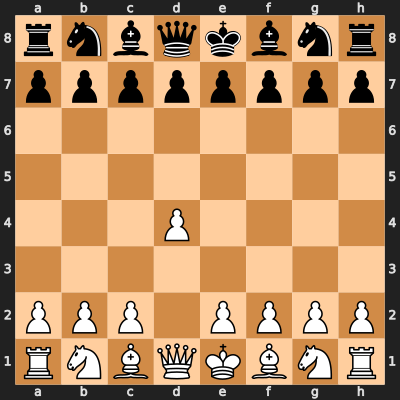

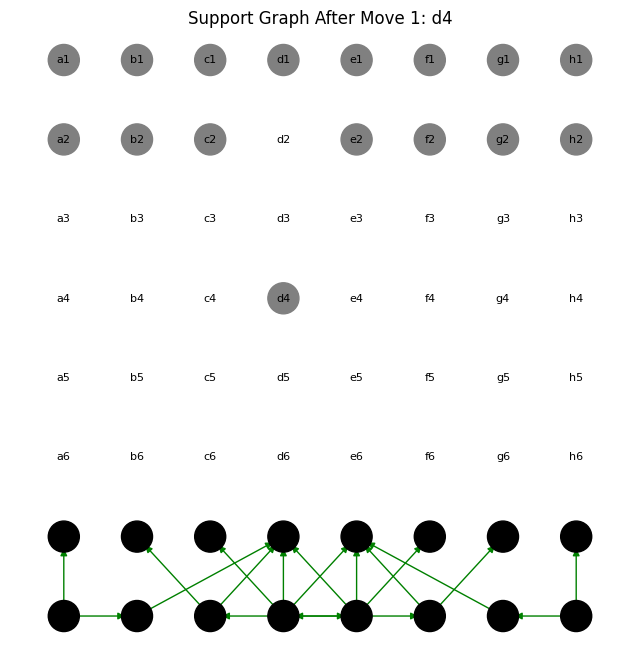

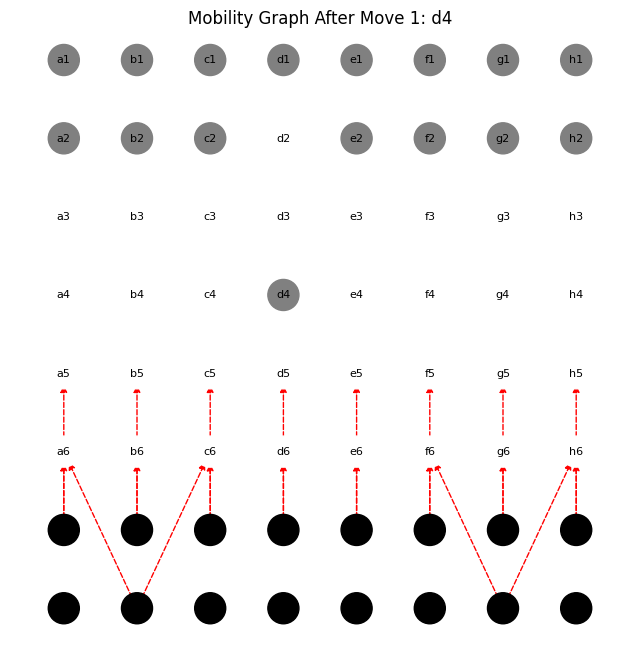

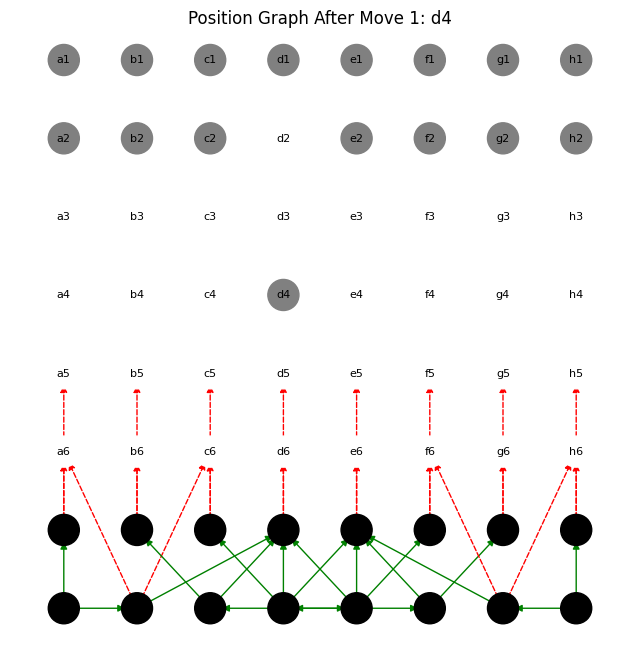

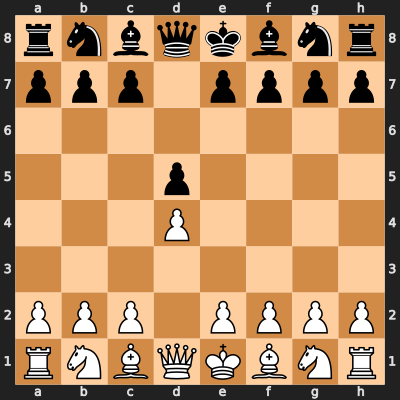

...

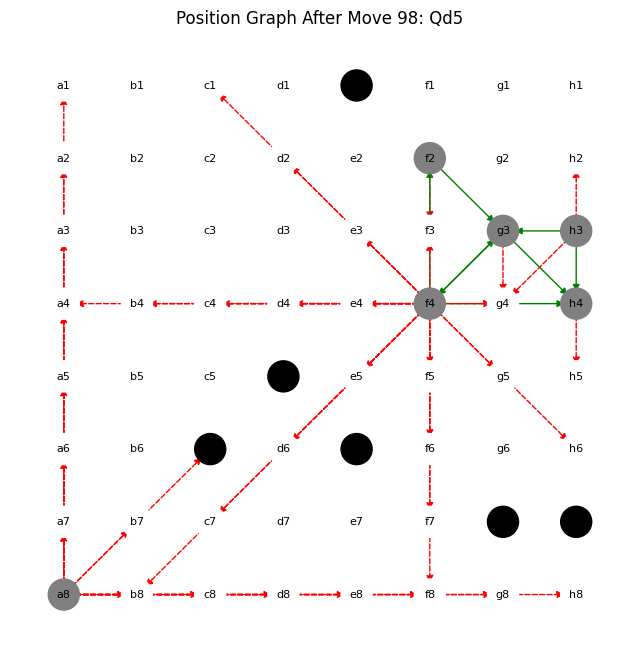

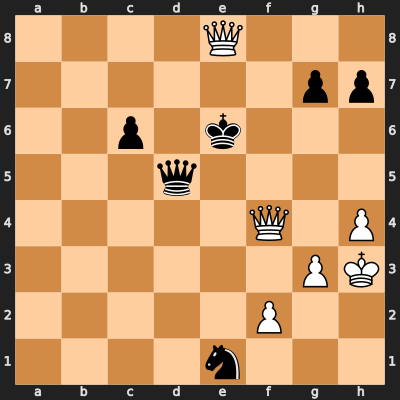

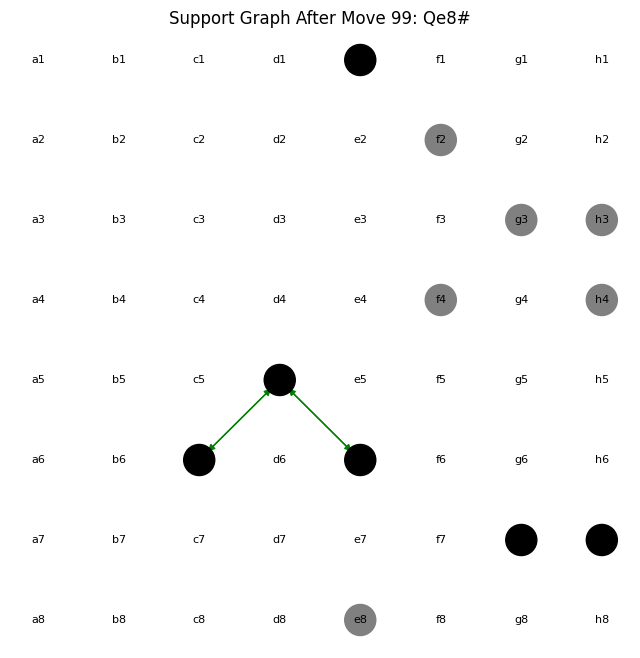

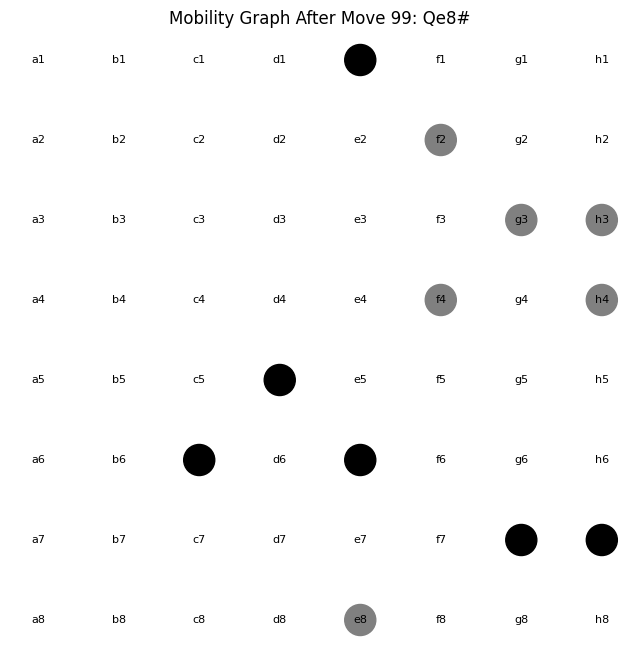

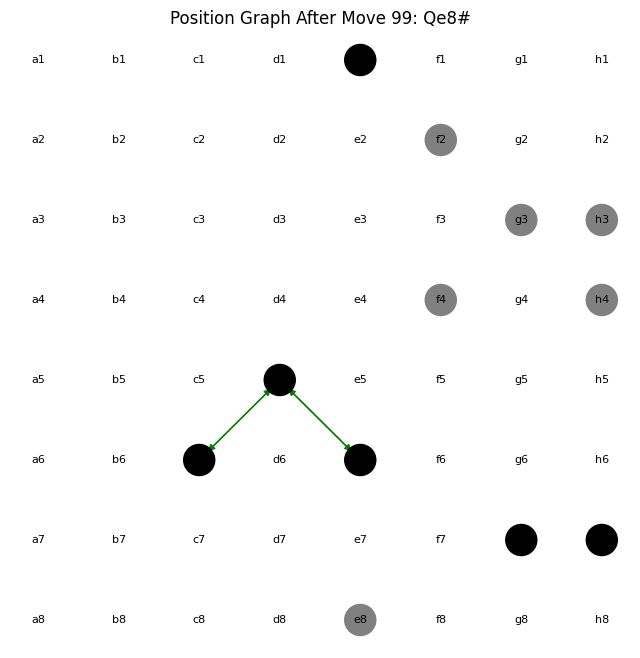

In [8]:
import chess
import chess.pgn
import chess.svg
import networkx as nx
import matplotlib.pyplot as plt
from IPython.display import SVG, display

# --- Draw Graph ---
def draw_graph(G, board, title):
    pos = {sq: (sq % 8, 7 - sq // 8) for sq in G.nodes()}
    node_colors = []

    for sq in G.nodes:
        piece = board.piece_at(sq)
        if piece is None:
            node_colors.append("white")
        else:
            node_colors.append("gray" if piece.color == chess.WHITE else "black")

    edge_colors = [G[u][v]['color'] for u, v in G.edges()]
    edge_styles = ['solid' if G[u][v]['type'] == 'support' else 'dashed' for u, v in G.edges()]

    plt.figure(figsize=(8, 8))
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=500)
    nx.draw_networkx_labels(G, pos, labels={sq: chess.square_name(sq) for sq in G.nodes()}, font_size=8)
    
    # Draw all edges at once
    nx.draw_networkx_edges(G, pos, edge_color=edge_colors, style=edge_styles, arrows=True)

    plt.title(title)
    plt.axis('off')
    plt.show()

# --- Create Support Network ---
def create_support_network(board):
    G = nx.DiGraph()
    current_color = board.turn
    for square in chess.SQUARES:
        G.add_node(square, color=board.piece_at(square).color if board.piece_at(square) else None)
    for square in chess.SQUARES:
        piece = board.piece_at(square)
        if piece and piece.color == current_color:
            for attacked_square in board.attacks(square):
                attacked_piece = board.piece_at(attacked_square)
                if attacked_piece and attacked_piece.color == current_color:
                    G.add_edge(square, attacked_square, color='green', type='support')
    return G

# --- Create Mobility Network ---
def create_mobility_network(board):
    G = nx.DiGraph()
    current_color = board.turn
    for square in chess.SQUARES:
        G.add_node(square, color=board.piece_at(square).color if board.piece_at(square) else None)
    for move in board.legal_moves:
        source = move.from_square
        dest = move.to_square
        piece = board.piece_at(source)
        if piece and piece.color == current_color:
            G.add_edge(source, dest, color='red', type='attack')
    return G

# --- Create Position Network ---
def create_position_network(support_G, mobility_G):
    G = nx.DiGraph()
    G.add_nodes_from(support_G.nodes(data=True))
    G.add_edges_from(support_G.edges(data=True))
    G.add_edges_from(mobility_G.edges(data=True))
    return G

# --- Visualize Game from PGN ---
def visualize_game_from_pgn(pgn_file):
    # Load the PGN file
    with open(pgn_file) as f:
        game = chess.pgn.read_game(f)

    board = game.board()  # Start from the initial board

    # Go through the moves of the game
    for i, move in enumerate(game.mainline_moves()):
        # Generate SAN notation before pushing the move
        san = board.san(move)

        board.push(move)  # Apply the move to the board

        # Display the board as SVG
        svg_board = chess.svg.board(board=board, size=400)
        display(SVG(svg_board))

        # Create support, mobility, and position networks after the move
        support_G = create_support_network(board)
        mobility_G = create_mobility_network(board)
        position_G = create_position_network(support_G, mobility_G)

        # Visualize the graphs for support, mobility, and position networks
        title_support = f"Support Graph After Move {i + 1}: {san}"
        title_mobility = f"Mobility Graph After Move {i + 1}: {san}"
        title_position = f"Position Graph After Move {i + 1}: {san}"

        draw_graph(support_G, board, title=title_support)
        draw_graph(mobility_G, board, title=title_mobility)
        draw_graph(position_G, board, title=title_position)

    return

# Call the function with the path to your .pgn file
visualize_game_from_pgn("test.pgn")